In [7]:
%matplotlib inline

# install pillow
!pip install Pillow -U

# download and unzip dataset o train
!wget http://images.cocodataset.org/zips/val2014.zip
!mkdir train
%cd /content/train
!unzip -qq /content/val2014.zip
%cd ..

#download model
!wget https://web.eecs.umich.edu/~justincj/models/vgg16-00b39a1b.pth

     |████████████████████████████████| 4.3 MB 14.5 MB/s 
  Attempting uninstall: Pillow
    Found existing installation: Pillow 7.1.2
    Uninstalling Pillow-7.1.2:
      Successfully uninstalled Pillow-7.1.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


--2022-05-05 17:06:17--  http://images.cocodataset.org/zips/val2014.zip
Resolving images.cocodataset.org (images.cocodataset.org)... 52.217.163.169
Connecting to images.cocodataset.org (images.cocodataset.org)|52.217.163.169|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6645013297 (6.2G) [application/zip]
Saving to: ‘val2014.zip’

val2014.zip         100%[===================>]   6.19G  34.9MB/s    in 3m 4s   

2022-05-05 17:09:22 (34.4 MB/s) - ‘val2014.zip’ saved [6645013297/6645013297]

/content/train
/content
--2022-05-05 17:10:02--  https://web.eecs.umich.edu/~justincj/models/vgg16-00b39a1b.pth
Resolving web.eecs.umich.edu (web.eecs.umich.edu)... 141.212.113.214
Connecting to web.eecs.umich.edu (web.eecs.umich.edu)|141.212.113.214|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 553451520 (528M) [application/x-tar]
Saving to: ‘vgg16-00b39a1b.pth’

vgg16-00b39a1b.pth  100%[===================>] 527.81M  29.2MB/s    in 19s     

2022

In [8]:
!pip install --ignore-installed Pillow==9.0.0

     |████████████████████████████████| 4.3 MB 14.2 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [1]:
import PIL
from PIL import Image
import matplotlib.pyplot as plt
import os
import cv2
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, transforms, models
import random
import numpy as np
import time
import vgg16_fe as vgg # this is used to extract features
import vgg16 as vgg_model # this is used to train the model
import utils

In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


# Trained on COCO dataset for VGG16 Model for different styles


## Rain Princess

In [10]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = "train"
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/rain_princess.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 17 # 17
STYLE_WEIGHT = 50 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "rain_princess/models/"
SAVE_IMAGE_PATH = "rain_princess/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

In [9]:
def train():
    # seeds
    torch.manual_seed(SEED)
    torch.cuda.manual_seed(SEED)
    np.random.seed(SEED)
    random.seed(SEED)

    # get the device
    device = ("cuda" if torch.cuda.is_available() else "cpu")

    # load the training dataset
    transform = transforms.Compose([
        transforms.Resize(TRAIN_IMAGE_SIZE),
        transforms.CenterCrop(TRAIN_IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Lambda(lambda x: x.mul(255))
    ])

    train_dataset = datasets.ImageFolder(DATASET_PATH, transform=transform)
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

    # load the models and start training :)
    model = vgg_model.VGG16('/content/vgg16-00b39a1b.pth').to(device) #Creating a pretrained model object by loading the downloaded .pth file. This model object will be retrained 
    vgg16_fe = vgg.VGG16('/content/vgg16-00b39a1b.pth').to(device) #Creating a pretrained model object by loading the downloaded .pth file. This model object will be used to extract features and will not be retrained

    # get style features
    imagenet_neg_mean = torch.tensor([-103.939, -116.779, -123.68], dtype=torch.float32).reshape(1,3,1,1).to(device)
    # load the style image
    style_image = utils.load_image(STYLE_IMAGE_PATH)
    # convert style image to tensor
    style_tensor = utils.itot(style_image).to(device)
    # add imagenet mean
    style_tensor = style_tensor.add(imagenet_neg_mean)

    B, C, H, W = style_tensor.shape
    # get the features of the style image
    style_features = vgg16_fe(style_tensor.expand([BATCH_SIZE, C, H, W]))

    # get the gram matrix of the style image
    style_gram = {}
    for key, value in style_features.items():
        style_gram[key] = utils.gram(value)

    # Optimizer settings
    optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=ADAM_LR)
    # optimizer = optim.Adam(model.parameters(), lr=ADAM_LR)

    # Loss trackers
    content_loss_history = []
    style_loss_history = []
    total_loss_history = []
    batch_content_loss_sum = 0
    batch_style_loss_sum = 0
    batch_total_loss_sum = 0

    # Optimization/Training Loop
    batch_count = 1
    start_time = time.time()

    # training loop
    for epoch in range(NUM_EPOCHS):
        print("========Epoch {}/{}========".format(epoch+1, NUM_EPOCHS))
        for content_batch, _ in train_loader:
            # Get current batch size in case of odd batch sizes
            curr_batch_size = content_batch.shape[0]

            # free up unnecessary memory of cuda
            torch.cuda.empty_cache()

            # zero the gradients
            optimizer.zero_grad()

            # Generate images and get features
            content_batch = content_batch[:,[2,1,0]].to(device)
            generated_batch = model(content_batch)

            # print("Content Batch: ", content_batch.shape)
            # print("Generated Batch: ", generated_batch.shape)

            content_features = vgg16_fe(content_batch.add(imagenet_neg_mean))
            generated_features = vgg16_fe(generated_batch.add(imagenet_neg_mean))

            # print("Generated Features:", generated_features['relu2_2'].shape)
            # print("Content Features:", content_features['relu2_2'].shape)

            # Calculate content loss
            MSELoss = nn.MSELoss().to(device)
            content_loss = CONTENT_WEIGHT * MSELoss(generated_features['relu2_2'], content_features['relu2_2'])            
            batch_content_loss_sum += content_loss

            # Calculate style loss
            style_loss = 0
            for key, value in generated_features.items():
                s_loss = MSELoss(utils.gram(value), style_gram[key][:curr_batch_size])
                style_loss += s_loss
            style_loss *= STYLE_WEIGHT
            batch_style_loss_sum += style_loss.item()

            # Calculate total loss
            total_loss = content_loss + style_loss
            batch_total_loss_sum += total_loss.item()

            # Backpropagation
            total_loss.backward()
            optimizer.step()

            # Save Model and Print Losses
            if (((batch_count-1)%SAVE_MODEL_EVERY == 0) or (batch_count==NUM_EPOCHS*len(train_loader))):
                # Print Losses
                print("========Iteration {}/{}========".format(batch_count, NUM_EPOCHS*len(train_loader)))
                print("\tContent Loss:\t{:.2f}".format(batch_content_loss_sum/batch_count))
                print("\tStyle Loss:\t{:.2f}".format(batch_style_loss_sum/batch_count))
                print("\tTotal Loss:\t{:.2f}".format(batch_total_loss_sum/batch_count))
                print("Time elapsed:\t{} seconds".format(time.time()-start_time))

                # Save Model
                checkpoint_path = SAVE_MODEL_PATH + "checkpoint_" + str(batch_count-1) + ".pth"
                torch.save(model.state_dict(), checkpoint_path)
                
                print("Saved self trained VGG16 checkpoint file at {}".format(checkpoint_path))

                # Save sample generated image
                sample_tensor = generated_batch[0].clone().detach().unsqueeze(dim=0) # clone to save inplace errors
                sample_image = utils.ttoi(sample_tensor.clone().detach())
                sample_image_path = SAVE_IMAGE_PATH + "sample0_" + str(batch_count-1) + ".png"
                utils.saveimg(sample_image, sample_image_path)
                utils.show(sample_image)
                print("Saved sample stylized image at {}".format(sample_image_path))

                # Save loss histories
                content_loss_history.append(batch_total_loss_sum/batch_count)
                style_loss_history.append(batch_style_loss_sum/batch_count)
                total_loss_history.append(batch_total_loss_sum/batch_count)
            
            # increment batch count
            batch_count += 1
    
    stop_time = time.time()
    # Print loss histories
    print("Done Training the Network!")
    print("Training Time: {} seconds".format(stop_time-start_time))
    print("========Content Loss========")
    print(content_loss_history) 
    print("========Style Loss========")
    print(style_loss_history) 
    print("========Total Loss========")
    print(total_loss_history) 

    # Save TransformerNetwork weights
    model.eval()
    model.cpu()
    final_path = SAVE_MODEL_PATH + "transformer_weight.pth"
    print("Saving VGG16 weights at {}".format(final_path))
    torch.save(model.state_dict(), final_path)
    print("Done saving final model")

    # Plot Loss Histories
    if (PLOT_LOSS):
        utils.plot_loss_hist(content_loss_history, style_loss_history, total_loss_history)


### Training

========Epoch 1/1========
========Iteration 1/10126========
	Content Loss:	3479169.50
	Style Loss:	73568904.00
	Total Loss:	77048072.00
Time elapsed:	0.3476371765136719 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_0.pth


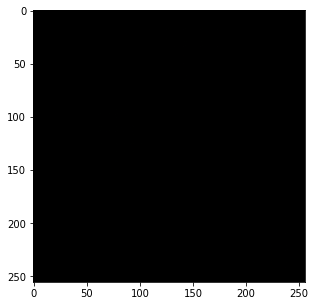

Saved sample stylized image at rain_princess/images/sample0_0.png
========Iteration 501/10126========
	Content Loss:	5231616.00
	Style Loss:	13975566.12
	Total Loss:	19207182.17
Time elapsed:	40.9076406955719 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_500.pth


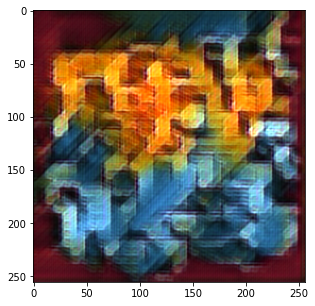

Saved sample stylized image at rain_princess/images/sample0_500.png
========Iteration 1001/10126========
	Content Loss:	5045204.50
	Style Loss:	7681927.84
	Total Loss:	12727132.77
Time elapsed:	80.6482367515564 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_1000.pth


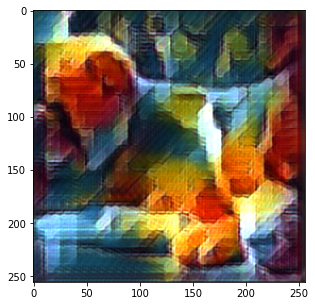

Saved sample stylized image at rain_princess/images/sample0_1000.png
========Iteration 1501/10126========
	Content Loss:	4828648.00
	Style Loss:	5486682.70
	Total Loss:	10315332.25
Time elapsed:	121.02309989929199 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_1500.pth


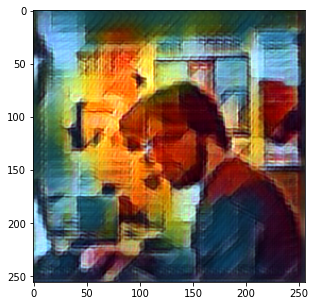

Saved sample stylized image at rain_princess/images/sample0_1500.png
========Iteration 2001/10126========
	Content Loss:	4647486.50
	Style Loss:	4365402.21
	Total Loss:	9012892.78
Time elapsed:	161.0609531402588 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_2000.pth


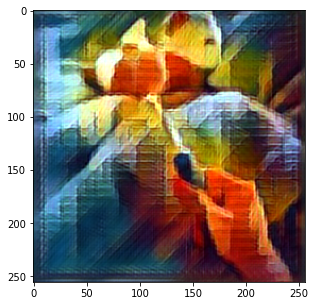

Saved sample stylized image at rain_princess/images/sample0_2000.png
========Iteration 2501/10126========
	Content Loss:	4500544.00
	Style Loss:	3681429.91
	Total Loss:	8181975.75
Time elapsed:	201.34972834587097 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_2500.pth


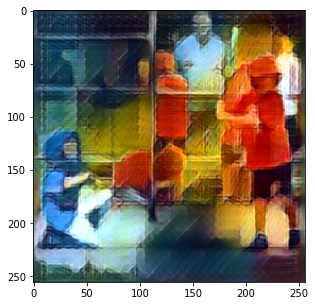

Saved sample stylized image at rain_princess/images/sample0_2500.png
========Iteration 3001/10126========
	Content Loss:	4372623.00
	Style Loss:	3216805.19
	Total Loss:	7589432.78
Time elapsed:	241.30441665649414 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_3000.pth


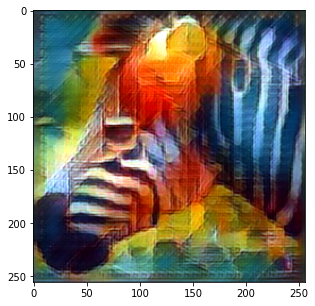

Saved sample stylized image at rain_princess/images/sample0_3000.png
========Iteration 3501/10126========
	Content Loss:	4270198.50
	Style Loss:	2880683.03
	Total Loss:	7150887.24
Time elapsed:	281.64583802223206 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_3500.pth


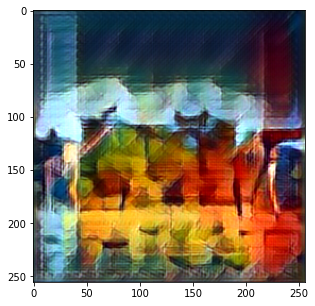

Saved sample stylized image at rain_princess/images/sample0_3500.png
========Iteration 4001/10126========
	Content Loss:	4182829.75
	Style Loss:	2626140.62
	Total Loss:	6808977.64
Time elapsed:	322.5401842594147 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_4000.pth


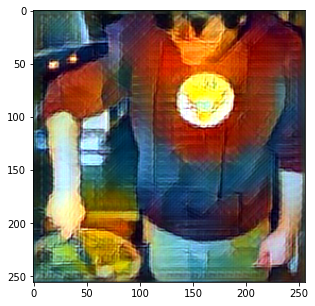

Saved sample stylized image at rain_princess/images/sample0_4000.png
========Iteration 4501/10126========
	Content Loss:	4109313.25
	Style Loss:	2426136.90
	Total Loss:	6535457.22
Time elapsed:	364.0676734447479 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_4500.pth


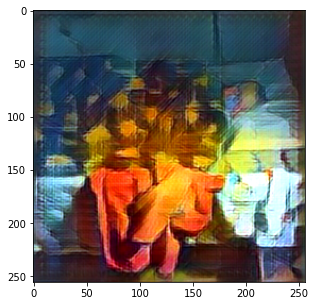

Saved sample stylized image at rain_princess/images/sample0_4500.png
========Iteration 5001/10126========
	Content Loss:	4040958.75
	Style Loss:	2264692.50
	Total Loss:	6305657.91
Time elapsed:	405.26667380332947 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_5000.pth


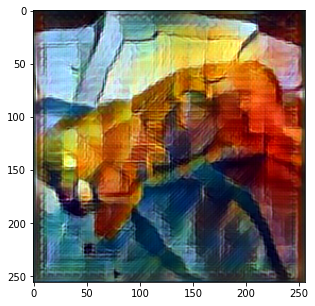

Saved sample stylized image at rain_princess/images/sample0_5000.png
========Iteration 5501/10126========
	Content Loss:	3984087.50
	Style Loss:	2131469.04
	Total Loss:	6115562.21
Time elapsed:	446.96296668052673 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_5500.pth


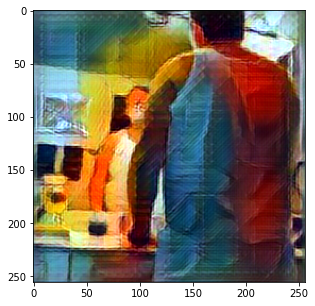

Saved sample stylized image at rain_princess/images/sample0_5500.png
========Iteration 6001/10126========
	Content Loss:	3934508.75
	Style Loss:	2019138.27
	Total Loss:	5953654.90
Time elapsed:	488.140967130661 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_6000.pth


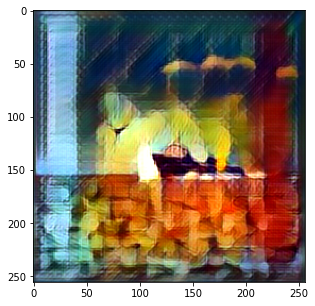

Saved sample stylized image at rain_princess/images/sample0_6000.png
========Iteration 6501/10126========
	Content Loss:	3887040.75
	Style Loss:	1923203.32
	Total Loss:	5810252.63
Time elapsed:	529.8853735923767 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_6500.pth


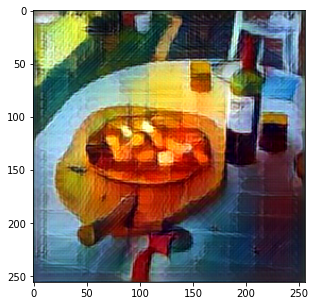

Saved sample stylized image at rain_princess/images/sample0_6500.png
========Iteration 7001/10126========
	Content Loss:	3845010.50
	Style Loss:	1841087.22
	Total Loss:	5686105.46
Time elapsed:	570.7053542137146 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_7000.pth


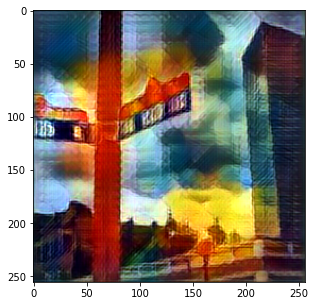

Saved sample stylized image at rain_princess/images/sample0_7000.png
========Iteration 7501/10126========
	Content Loss:	3805935.50
	Style Loss:	1769417.31
	Total Loss:	5575360.68
Time elapsed:	612.1349935531616 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_7500.pth


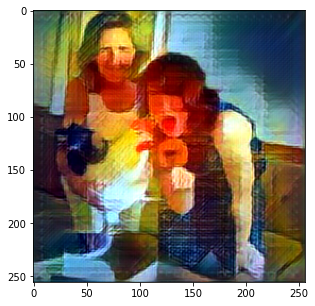

Saved sample stylized image at rain_princess/images/sample0_7500.png
========Iteration 8001/10126========
	Content Loss:	3771067.50
	Style Loss:	1705731.51
	Total Loss:	5476807.78
Time elapsed:	652.8786227703094 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_8000.pth


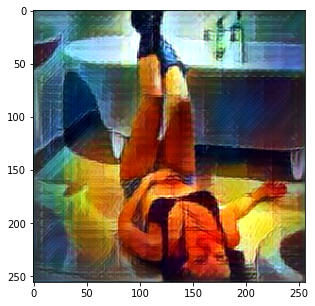

Saved sample stylized image at rain_princess/images/sample0_8000.png
========Iteration 8501/10126========
	Content Loss:	3739703.75
	Style Loss:	1649376.99
	Total Loss:	5389090.88
Time elapsed:	694.0060091018677 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_8500.pth


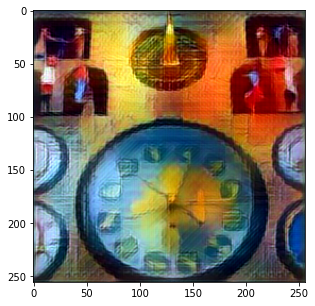

Saved sample stylized image at rain_princess/images/sample0_8500.png
========Iteration 9001/10126========
	Content Loss:	3709623.25
	Style Loss:	1598389.85
	Total Loss:	5308022.46
Time elapsed:	734.5613687038422 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_9000.pth


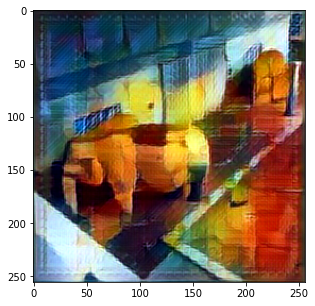

Saved sample stylized image at rain_princess/images/sample0_9000.png
========Iteration 9501/10126========
	Content Loss:	3682312.25
	Style Loss:	1552867.38
	Total Loss:	5235189.35
Time elapsed:	776.0744531154633 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_9500.pth


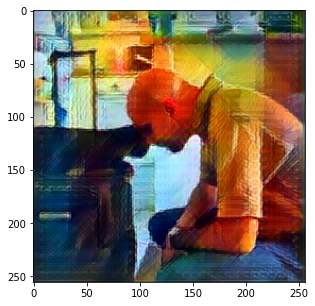

Saved sample stylized image at rain_princess/images/sample0_9500.png
========Iteration 10001/10126========
	Content Loss:	3656548.50
	Style Loss:	1511581.64
	Total Loss:	5168140.15
Time elapsed:	818.2247993946075 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_10000.pth


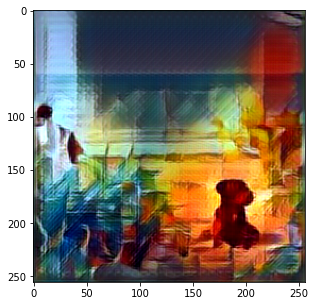

Saved sample stylized image at rain_princess/images/sample0_10000.png
========Iteration 10126/10126========
	Content Loss:	3650472.50
	Style Loss:	1501899.07
	Total Loss:	5152383.13
Time elapsed:	830.6521117687225 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_10125.pth


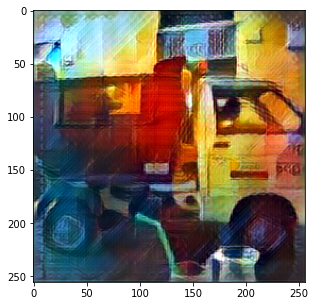

Saved sample stylized image at rain_princess/images/sample0_10125.png
Done Training the Network!
Training Time: 831.0614793300629 seconds
========Content Loss========
[77048072.0, 19207182.172654692, 12727132.76973027, 10315332.253497668, 9012892.777111445, 8181975.753898441, 7589432.78023992, 7150887.235718366, 6808977.643214197, 6535457.221284159, 6305657.905168966, 6115562.210279949, 5953654.899641726, 5810252.626019074, 5686105.464219397, 5575360.681709105, 5476807.783027122, 5389090.884219504, 5308022.464004, 5235189.350963056, 5168140.154709529, 5152383.134727434]
========Style Loss========
[73568904.0, 13975566.12250499, 7681927.840659341, 5486682.697160226, 4365402.212831085, 3681429.9134096364, 3216805.185313229, 2880683.0347936302, 2626140.619267058, 2426136.9031048655, 2264692.5001624674, 2131469.0357889473, 2019138.2742876187, 1923203.323392555, 1841087.2184687902, 1769417.3102836288, 1705731.5103033995, 1649376.994787378, 1598389.8541828685, 1552867.3759406905, 1511581.642

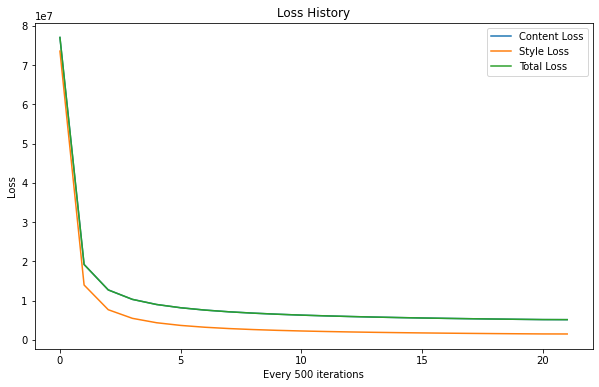

In [11]:
train()

In [12]:
# copy the models folder to the folder in the google drive
!cp -r rain_princess/models/ /content/gdrive/My\ Drive/vgg_coco/rain_princess/
# copy the images folder to the folder in the google drive
!cp -r rain_princess/images/ /content/gdrive/My\ Drive/vgg_coco/rain_princess/

## The Scream

In [13]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = "train"
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/the_scream.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 17 # 17
STYLE_WEIGHT = 50 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "the_scream/models/"
SAVE_IMAGE_PATH = "the_scream/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

========Epoch 1/1========
========Iteration 1/10126========
	Content Loss:	3479169.50
	Style Loss:	25371900.00
	Total Loss:	28851070.00
Time elapsed:	0.14824247360229492 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_0.pth


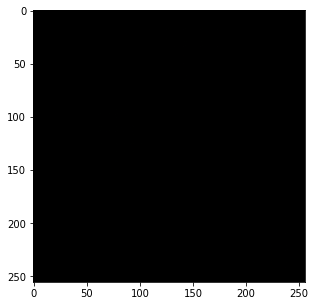

Saved sample stylized image at the_scream/images/sample0_0.png
========Iteration 501/10126========
	Content Loss:	2934509.00
	Style Loss:	3052777.99
	Total Loss:	5987287.96
Time elapsed:	37.23433494567871 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_500.pth


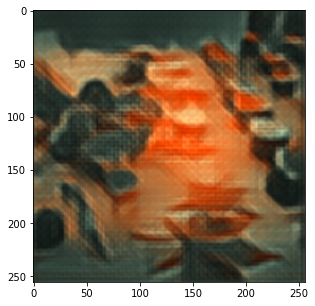

Saved sample stylized image at the_scream/images/sample0_500.png
========Iteration 1001/10126========
	Content Loss:	2629418.50
	Style Loss:	1698769.38
	Total Loss:	4328189.46
Time elapsed:	74.03729176521301 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_1000.pth


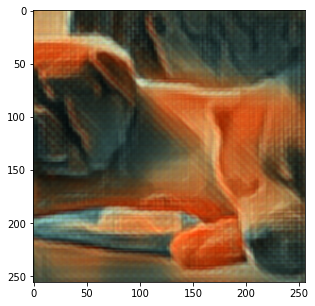

Saved sample stylized image at the_scream/images/sample0_1000.png
========Iteration 1501/10126========
	Content Loss:	2466275.00
	Style Loss:	1239140.77
	Total Loss:	3705414.16
Time elapsed:	111.01885843276978 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_1500.pth


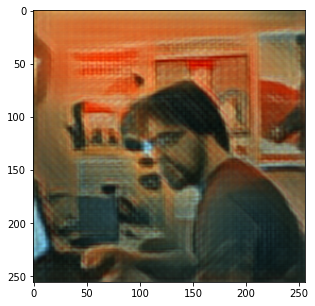

Saved sample stylized image at the_scream/images/sample0_1500.png
========Iteration 2001/10126========
	Content Loss:	2352531.75
	Style Loss:	1007655.09
	Total Loss:	3360184.68
Time elapsed:	148.06290483474731 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_2000.pth


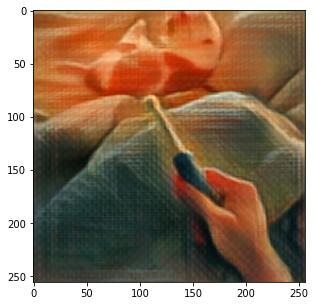

Saved sample stylized image at the_scream/images/sample0_2000.png
========Iteration 2501/10126========
	Content Loss:	2272148.00
	Style Loss:	868537.14
	Total Loss:	3140685.74
Time elapsed:	184.60892796516418 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_2500.pth


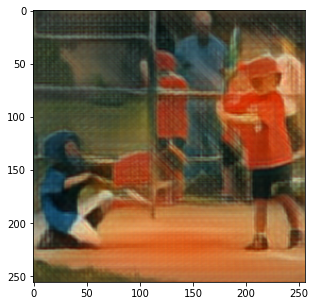

Saved sample stylized image at the_scream/images/sample0_2500.png
========Iteration 3001/10126========
	Content Loss:	2196543.25
	Style Loss:	774392.55
	Total Loss:	2970936.28
Time elapsed:	221.3688554763794 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_3000.pth


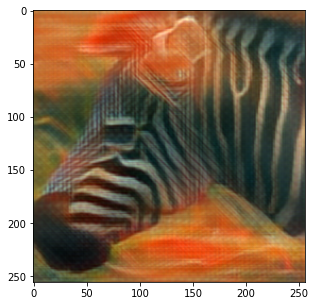

Saved sample stylized image at the_scream/images/sample0_3000.png
========Iteration 3501/10126========
	Content Loss:	2144341.75
	Style Loss:	706918.21
	Total Loss:	2851261.38
Time elapsed:	258.37089920043945 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_3500.pth


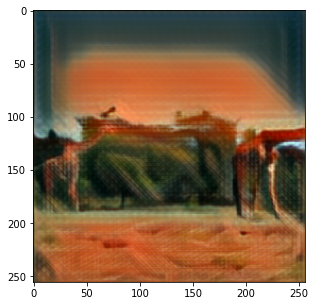

Saved sample stylized image at the_scream/images/sample0_3500.png
========Iteration 4001/10126========
	Content Loss:	2100712.25
	Style Loss:	656188.41
	Total Loss:	2756900.79
Time elapsed:	295.088219165802 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_4000.pth


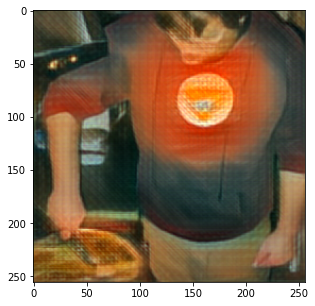

Saved sample stylized image at the_scream/images/sample0_4000.png
========Iteration 4501/10126========
	Content Loss:	2065137.25
	Style Loss:	616583.26
	Total Loss:	2681722.20
Time elapsed:	331.76263189315796 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_4500.pth


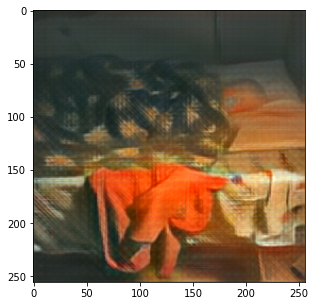

Saved sample stylized image at the_scream/images/sample0_4500.png
========Iteration 5001/10126========
	Content Loss:	2028939.12
	Style Loss:	584488.36
	Total Loss:	2613427.07
Time elapsed:	368.2203302383423 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_5000.pth


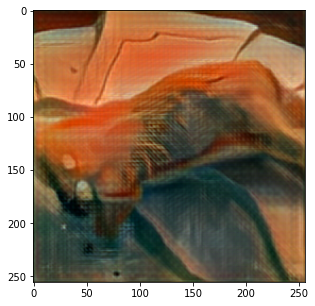

Saved sample stylized image at the_scream/images/sample0_5000.png
========Iteration 5501/10126========
	Content Loss:	2003475.25
	Style Loss:	558233.42
	Total Loss:	2561709.41
Time elapsed:	404.8570947647095 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_5500.pth


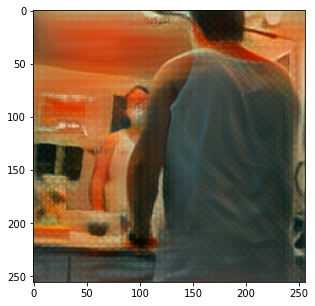

Saved sample stylized image at the_scream/images/sample0_5500.png
========Iteration 6001/10126========
	Content Loss:	1982086.50
	Style Loss:	536447.09
	Total Loss:	2518532.19
Time elapsed:	441.42228722572327 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_6000.pth


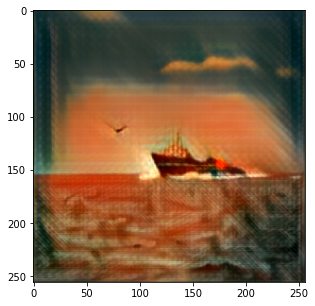

Saved sample stylized image at the_scream/images/sample0_6000.png
========Iteration 6501/10126========
	Content Loss:	1960140.88
	Style Loss:	517628.29
	Total Loss:	2477768.12
Time elapsed:	478.09315276145935 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_6500.pth


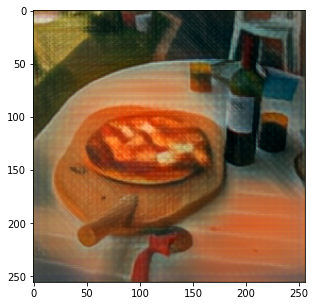

Saved sample stylized image at the_scream/images/sample0_6500.png
========Iteration 7001/10126========
	Content Loss:	1938031.88
	Style Loss:	501463.98
	Total Loss:	2439495.05
Time elapsed:	514.5791289806366 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_7000.pth


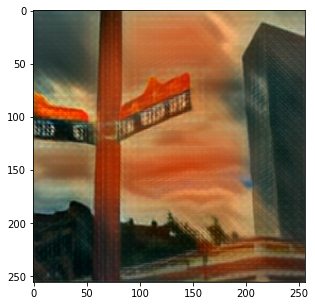

Saved sample stylized image at the_scream/images/sample0_7000.png
========Iteration 7501/10126========
	Content Loss:	1919251.00
	Style Loss:	487540.45
	Total Loss:	2406790.41
Time elapsed:	551.046716928482 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_7500.pth


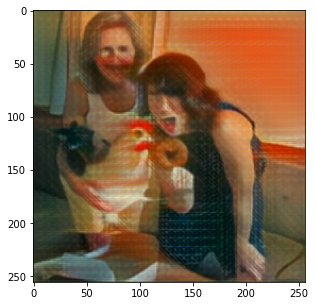

Saved sample stylized image at the_scream/images/sample0_7500.png
========Iteration 8001/10126========
	Content Loss:	1902595.00
	Style Loss:	475302.31
	Total Loss:	2377897.17
Time elapsed:	587.8143842220306 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_8000.pth


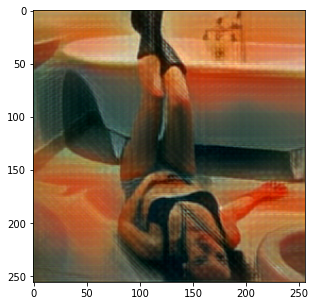

Saved sample stylized image at the_scream/images/sample0_8000.png
========Iteration 8501/10126========
	Content Loss:	1889035.25
	Style Loss:	464453.82
	Total Loss:	2353489.85
Time elapsed:	624.0920724868774 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_8500.pth


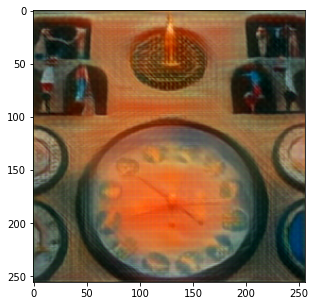

Saved sample stylized image at the_scream/images/sample0_8500.png
========Iteration 9001/10126========
	Content Loss:	1875755.75
	Style Loss:	454652.59
	Total Loss:	2330407.85
Time elapsed:	659.9910666942596 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_9000.pth


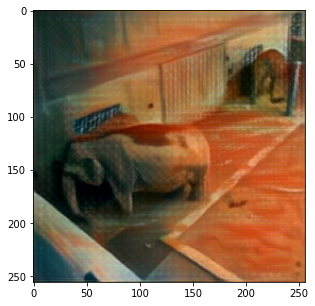

Saved sample stylized image at the_scream/images/sample0_9000.png
========Iteration 9501/10126========
	Content Loss:	1862417.75
	Style Loss:	445844.88
	Total Loss:	2308263.74
Time elapsed:	696.0974571704865 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_9500.pth


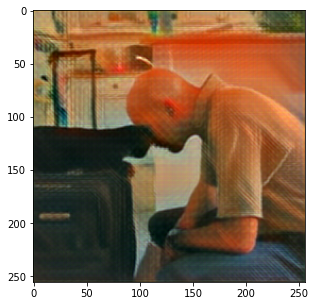

Saved sample stylized image at the_scream/images/sample0_9500.png
========Iteration 10001/10126========
	Content Loss:	1850936.38
	Style Loss:	437965.03
	Total Loss:	2288903.12
Time elapsed:	732.1593799591064 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_10000.pth


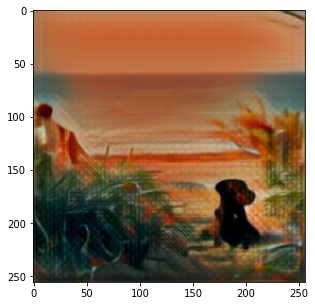

Saved sample stylized image at the_scream/images/sample0_10000.png
========Iteration 10126/10126========
	Content Loss:	1847768.50
	Style Loss:	436081.73
	Total Loss:	2283851.92
Time elapsed:	741.4622030258179 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_10125.pth


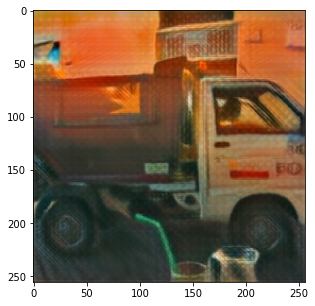

Saved sample stylized image at the_scream/images/sample0_10125.png
Done Training the Network!
Training Time: 741.7933669090271 seconds
========Content Loss========
[28851070.0, 5987287.958582834, 4328189.4585414585, 3705414.1578947366, 3360184.6750374814, 3140685.744002399, 2970936.2820726424, 2851261.3780705514, 2756900.7948950264, 2681722.1986503, 2613427.073110378, 2561709.4064715505, 2518532.1949883355, 2477768.119500846, 2439495.0505463504, 2406790.414344754, 2377897.1723065865, 2353489.854252441, 2330407.847489168, 2308263.743908536, 2288903.12150035, 2283851.922106459]
========Style Loss========
[25371900.0, 3052777.9923278443, 1698769.3782623627, 1239140.7660622085, 1007655.0887368815, 868537.1374762595, 774392.5477913612, 706918.2052003, 656188.4083744689, 616583.2578558931, 584488.3583158369, 558233.418938034, 536447.0850196842, 517628.2873812683, 501463.9760815419, 487540.45301876415, 475302.31261521997, 464453.82160187035, 454652.5883530302, 445844.87538318336, 437965.03217

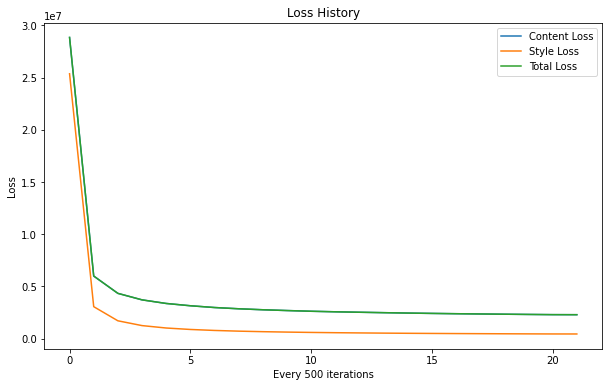

In [14]:
train()

In [15]:
# copy the models folder to the folder in the google drive
!cp -r the_scream/models/ /content/gdrive/My\ Drive/vgg_coco/the_scream/
# copy the images folder to the folder in the google drive
!cp -r the_scream/images/ /content/gdrive/My\ Drive/vgg_coco/the_scream/

## The Shipwreck

In [16]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = "train"
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/the_shipwreck.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 17 # 17
STYLE_WEIGHT = 50 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "the_shipwreck/models/"
SAVE_IMAGE_PATH = "the_shipwreck/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

========Epoch 1/1========
========Iteration 1/10126========
	Content Loss:	3479169.50
	Style Loss:	20102498.00
	Total Loss:	23581668.00
Time elapsed:	0.2149190902709961 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_0.pth


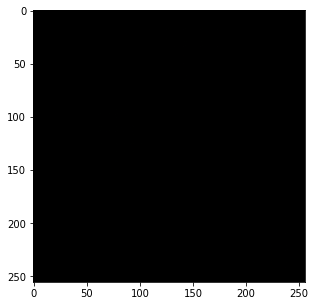

Saved sample stylized image at the_shipwreck/images/sample0_0.png
========Iteration 501/10126========
	Content Loss:	2941715.25
	Style Loss:	2372853.72
	Total Loss:	5314568.93
Time elapsed:	38.812291860580444 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_500.pth


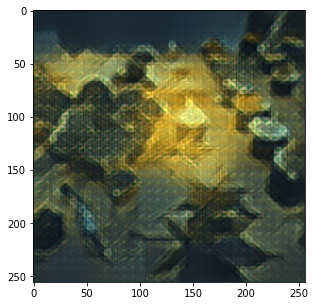

Saved sample stylized image at the_shipwreck/images/sample0_500.png
========Iteration 1001/10126========
	Content Loss:	2691918.25
	Style Loss:	1342995.71
	Total Loss:	4034913.98
Time elapsed:	76.7627260684967 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_1000.pth


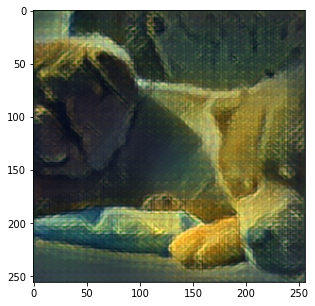

Saved sample stylized image at the_shipwreck/images/sample0_1000.png
========Iteration 1501/10126========
	Content Loss:	2536195.25
	Style Loss:	992221.56
	Total Loss:	3528417.07
Time elapsed:	115.21791505813599 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_1500.pth


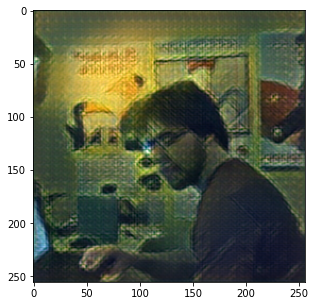

Saved sample stylized image at the_shipwreck/images/sample0_1500.png
========Iteration 2001/10126========
	Content Loss:	2426537.75
	Style Loss:	815338.54
	Total Loss:	3241877.41
Time elapsed:	153.34145307540894 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_2000.pth


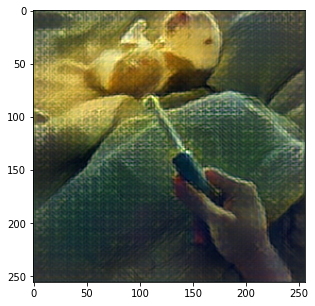

Saved sample stylized image at the_shipwreck/images/sample0_2000.png
========Iteration 2501/10126========
	Content Loss:	2349880.75
	Style Loss:	709393.17
	Total Loss:	3059275.75
Time elapsed:	191.5277078151703 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_2500.pth


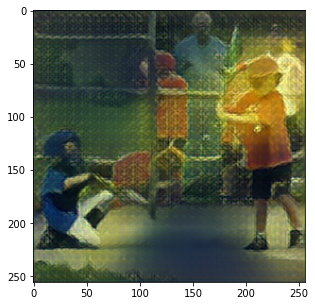

Saved sample stylized image at the_shipwreck/images/sample0_2500.png
========Iteration 3001/10126========
	Content Loss:	2278583.25
	Style Loss:	637590.08
	Total Loss:	2916176.16
Time elapsed:	229.59062147140503 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_3000.pth


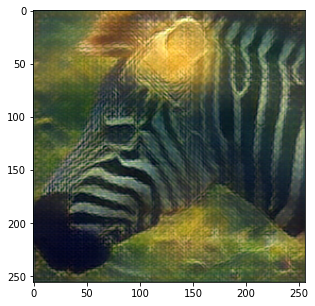

Saved sample stylized image at the_shipwreck/images/sample0_3000.png
========Iteration 3501/10126========
	Content Loss:	2229216.50
	Style Loss:	586448.34
	Total Loss:	2815668.01
Time elapsed:	267.82718873023987 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_3500.pth


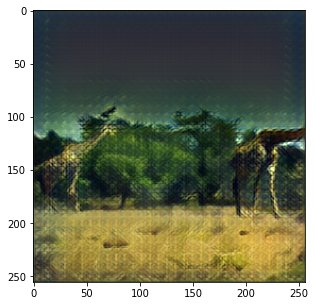

Saved sample stylized image at the_shipwreck/images/sample0_3500.png
========Iteration 4001/10126========
	Content Loss:	2187460.50
	Style Loss:	548030.06
	Total Loss:	2735492.62
Time elapsed:	306.0413599014282 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_4000.pth


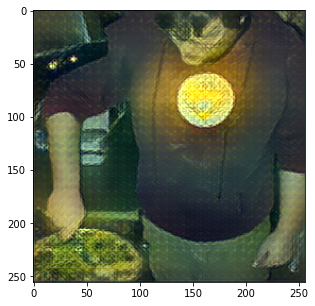

Saved sample stylized image at the_shipwreck/images/sample0_4000.png
========Iteration 4501/10126========
	Content Loss:	2153480.00
	Style Loss:	518033.39
	Total Loss:	2671516.38
Time elapsed:	344.02799129486084 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_4500.pth


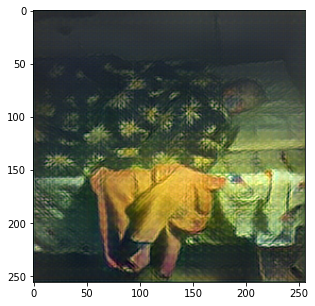

Saved sample stylized image at the_shipwreck/images/sample0_4500.png
========Iteration 5001/10126========
	Content Loss:	2119338.75
	Style Loss:	493699.79
	Total Loss:	2613042.60
Time elapsed:	382.22322702407837 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_5000.pth


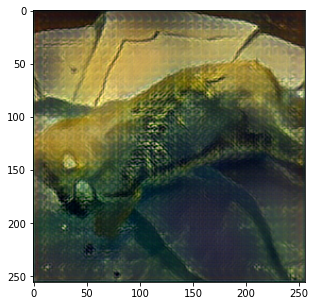

Saved sample stylized image at the_shipwreck/images/sample0_5000.png
========Iteration 5501/10126========
	Content Loss:	2094944.50
	Style Loss:	473927.08
	Total Loss:	2568873.90
Time elapsed:	420.73711013793945 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_5500.pth


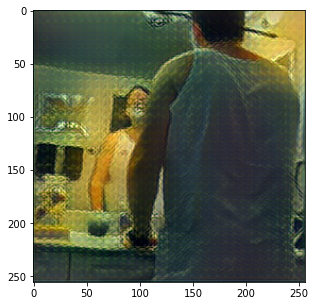

Saved sample stylized image at the_shipwreck/images/sample0_5500.png
========Iteration 6001/10126========
	Content Loss:	2073986.38
	Style Loss:	457343.80
	Total Loss:	2531331.85
Time elapsed:	458.97451639175415 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_6000.pth


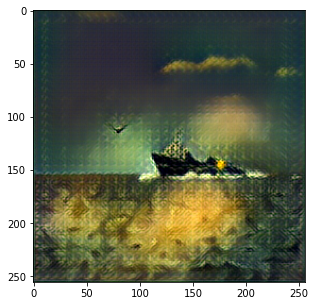

Saved sample stylized image at the_shipwreck/images/sample0_6000.png
========Iteration 6501/10126========
	Content Loss:	2053061.38
	Style Loss:	443167.46
	Total Loss:	2496230.63
Time elapsed:	497.0835464000702 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_6500.pth


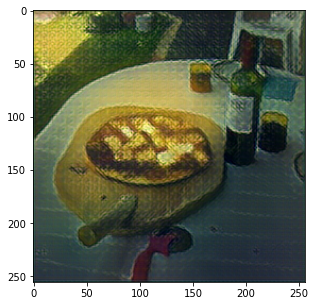

Saved sample stylized image at the_shipwreck/images/sample0_6500.png
========Iteration 7001/10126========
	Content Loss:	2031836.75
	Style Loss:	430929.01
	Total Loss:	2462767.55
Time elapsed:	535.1366121768951 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_7000.pth


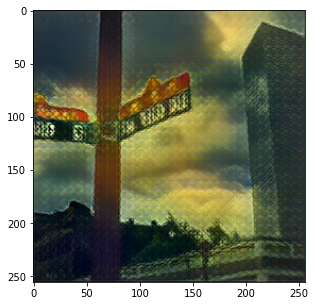

Saved sample stylized image at the_shipwreck/images/sample0_7000.png
========Iteration 7501/10126========
	Content Loss:	2013580.38
	Style Loss:	420455.22
	Total Loss:	2434037.16
Time elapsed:	573.1702699661255 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_7500.pth


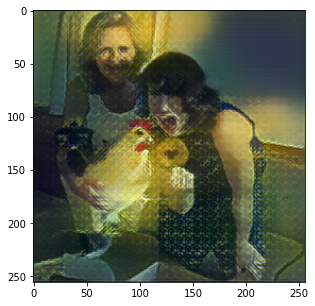

Saved sample stylized image at the_shipwreck/images/sample0_7500.png
========Iteration 8001/10126========
	Content Loss:	1997214.62
	Style Loss:	411136.56
	Total Loss:	2408352.03
Time elapsed:	611.4215245246887 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_8000.pth


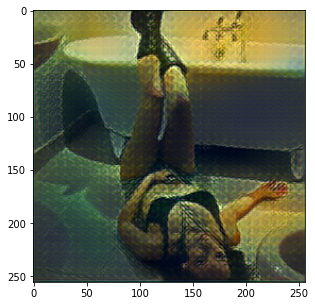

Saved sample stylized image at the_shipwreck/images/sample0_8000.png
========Iteration 8501/10126========
	Content Loss:	1983832.38
	Style Loss:	402968.62
	Total Loss:	2386801.17
Time elapsed:	649.4857044219971 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_8500.pth


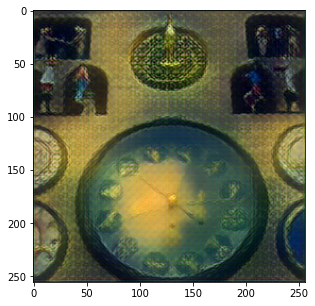

Saved sample stylized image at the_shipwreck/images/sample0_8500.png
========Iteration 9001/10126========
	Content Loss:	1970564.62
	Style Loss:	395565.87
	Total Loss:	2366132.28
Time elapsed:	687.5043458938599 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_9000.pth


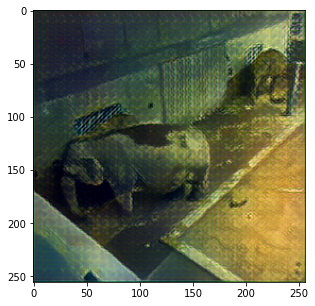

Saved sample stylized image at the_shipwreck/images/sample0_9000.png
========Iteration 9501/10126========
	Content Loss:	1957431.75
	Style Loss:	388902.12
	Total Loss:	2346336.33
Time elapsed:	725.9425709247589 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_9500.pth


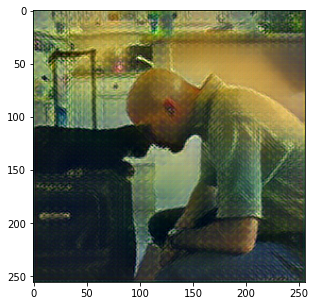

Saved sample stylized image at the_shipwreck/images/sample0_9500.png
========Iteration 10001/10126========
	Content Loss:	1945885.50
	Style Loss:	382911.30
	Total Loss:	2328800.45
Time elapsed:	763.7627704143524 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_10000.pth


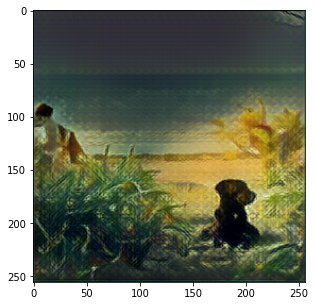

Saved sample stylized image at the_shipwreck/images/sample0_10000.png
========Iteration 10126/10126========
	Content Loss:	1942867.00
	Style Loss:	381497.41
	Total Loss:	2324368.59
Time elapsed:	774.6365377902985 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_10125.pth


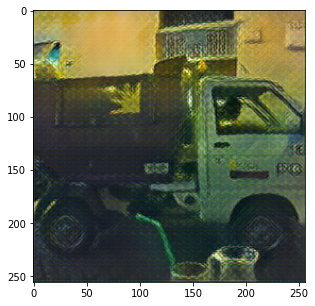

Saved sample stylized image at the_shipwreck/images/sample0_10125.png
Done Training the Network!
Training Time: 775.0440492630005 seconds
========Content Loss========
[23581668.0, 5314568.93013972, 4034913.983891109, 3528417.07203531, 3241877.4146051975, 3059275.7477508998, 2916176.155031656, 2815668.008461868, 2735492.617033242, 2671516.3815263277, 2613042.600654869, 2568873.9005180877, 2531331.848671055, 2496230.6264805417, 2462767.552206828, 2434037.155012665, 2408352.033183352, 2386801.173303141, 2366132.2768859016, 2346336.3257288705, 2328800.4543045694, 2324368.592682204]
========Style Loss========
[20102498.0, 2372853.719498503, 1342995.7144261987, 992221.5609281312, 815338.5380590955, 709393.1707941823, 637590.0811916861, 586448.3406839117, 548030.0550448325, 518033.3894828927, 493699.7887016347, 473927.0799712552, 457343.80253030744, 443167.46140497614, 430929.00763283815, 420455.2180875883, 411136.5645837239, 402968.6210078226, 395565.8666380819, 388902.1185565993, 382911.302

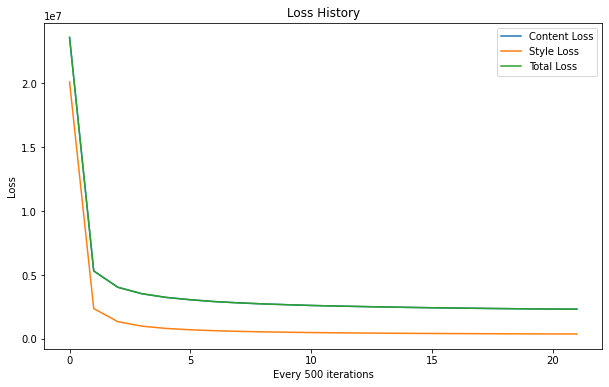

In [17]:
train()

In [18]:
# copy the models folder to the folder in the google drive
!cp -r the_shipwreck/models/ /content/gdrive/My\ Drive/vgg_coco/the_shipwreck/
# copy the images folder to the folder in the google drive
!cp -r the_shipwreck/images/ /content/gdrive/My\ Drive/vgg_coco/the_shipwreck/

## Udnie

In [19]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = "train"
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/udnie.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 17 # 17
STYLE_WEIGHT = 50 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "udnie/models/"
SAVE_IMAGE_PATH = "udnie/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

========Epoch 1/1========
========Iteration 1/10126========
	Content Loss:	3479169.50
	Style Loss:	20238216.00
	Total Loss:	23717386.00
Time elapsed:	0.13085389137268066 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_0.pth


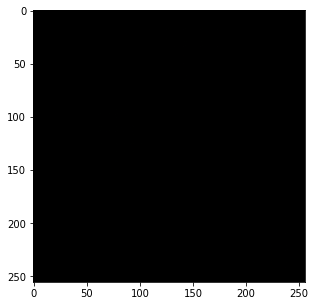

Saved sample stylized image at udnie/images/sample0_0.png
========Iteration 501/10126========
	Content Loss:	3158395.75
	Style Loss:	3324268.32
	Total Loss:	6482663.28
Time elapsed:	45.94710874557495 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_500.pth


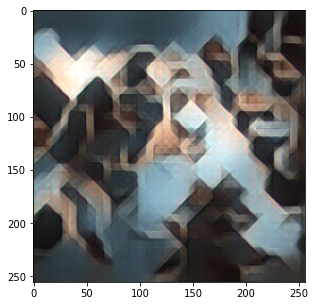

Saved sample stylized image at udnie/images/sample0_500.png
========Iteration 1001/10126========
	Content Loss:	2888786.00
	Style Loss:	1991598.40
	Total Loss:	4880383.82
Time elapsed:	90.8753514289856 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_1000.pth


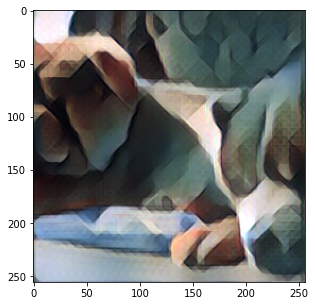

Saved sample stylized image at udnie/images/sample0_1000.png
========Iteration 1501/10126========
	Content Loss:	2671493.50
	Style Loss:	1504754.56
	Total Loss:	4176247.41
Time elapsed:	136.38040161132812 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_1500.pth


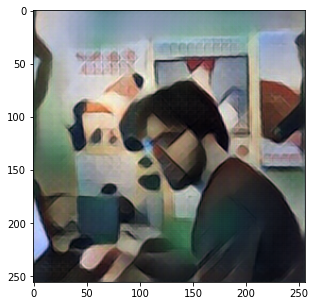

Saved sample stylized image at udnie/images/sample0_1500.png
========Iteration 2001/10126========
	Content Loss:	2517038.00
	Style Loss:	1248311.15
	Total Loss:	3765349.87
Time elapsed:	181.44478559494019 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_2000.pth


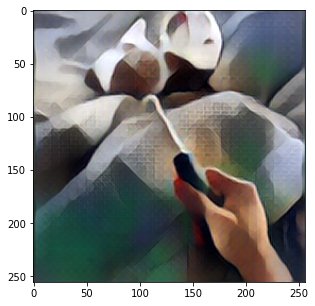

Saved sample stylized image at udnie/images/sample0_2000.png
========Iteration 2501/10126========
	Content Loss:	2407745.25
	Style Loss:	1086715.59
	Total Loss:	3494460.35
Time elapsed:	227.16341304779053 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_2500.pth


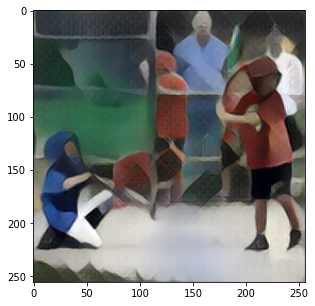

Saved sample stylized image at udnie/images/sample0_2500.png
========Iteration 3001/10126========
	Content Loss:	2315168.75
	Style Loss:	976307.22
	Total Loss:	3291474.56
Time elapsed:	272.1324257850647 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_3000.pth


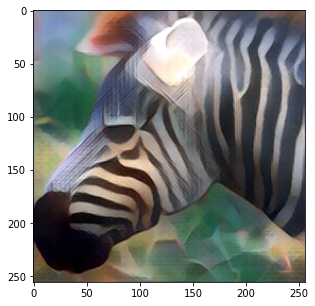

Saved sample stylized image at udnie/images/sample0_3000.png
========Iteration 3501/10126========
	Content Loss:	2250191.50
	Style Loss:	896068.76
	Total Loss:	3146257.58
Time elapsed:	317.46462845802307 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_3500.pth


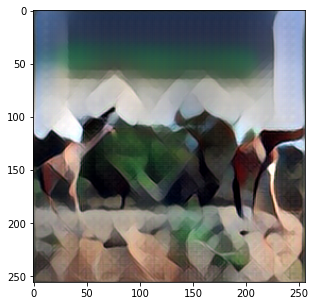

Saved sample stylized image at udnie/images/sample0_3500.png
========Iteration 4001/10126========
	Content Loss:	2195442.00
	Style Loss:	834695.79
	Total Loss:	3030134.82
Time elapsed:	362.40711402893066 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_4000.pth


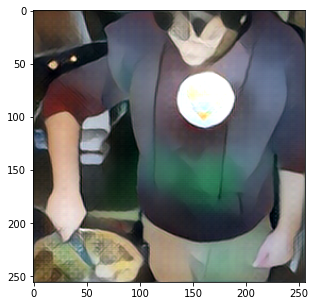

Saved sample stylized image at udnie/images/sample0_4000.png
========Iteration 4501/10126========
	Content Loss:	2151474.00
	Style Loss:	786802.43
	Total Loss:	2938273.70
Time elapsed:	407.8360753059387 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_4500.pth


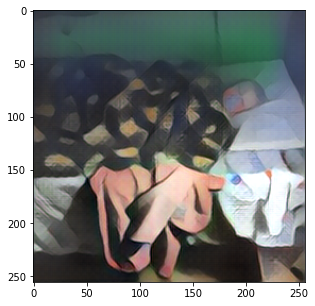

Saved sample stylized image at udnie/images/sample0_4500.png
========Iteration 5001/10126========
	Content Loss:	2108403.75
	Style Loss:	747600.10
	Total Loss:	2855998.21
Time elapsed:	453.413937330246 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_5000.pth


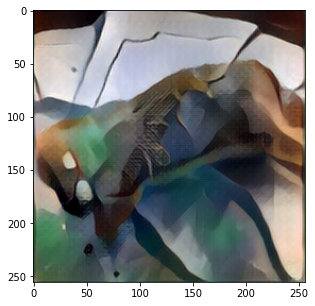

Saved sample stylized image at udnie/images/sample0_5000.png
========Iteration 5501/10126========
	Content Loss:	2077278.62
	Style Loss:	715765.77
	Total Loss:	2793040.53
Time elapsed:	498.9851315021515 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_5500.pth


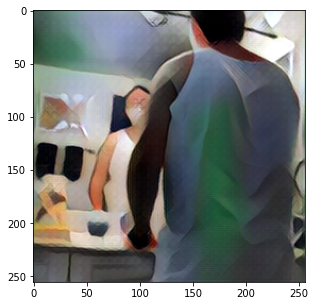

Saved sample stylized image at udnie/images/sample0_5500.png
========Iteration 6001/10126========
	Content Loss:	2050988.50
	Style Loss:	688989.21
	Total Loss:	2739972.95
Time elapsed:	544.382734298706 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_6000.pth


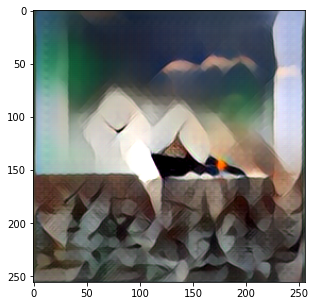

Saved sample stylized image at udnie/images/sample0_6000.png
========Iteration 6501/10126========
	Content Loss:	2025204.25
	Style Loss:	665817.38
	Total Loss:	2691017.65
Time elapsed:	589.8651282787323 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_6500.pth


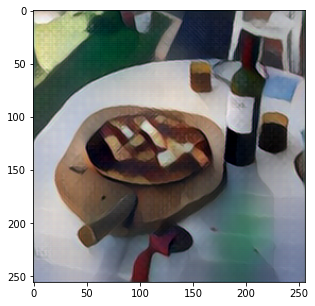

Saved sample stylized image at udnie/images/sample0_6500.png
========Iteration 7001/10126========
	Content Loss:	2000170.75
	Style Loss:	646083.98
	Total Loss:	2646250.72
Time elapsed:	634.9023990631104 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_7000.pth


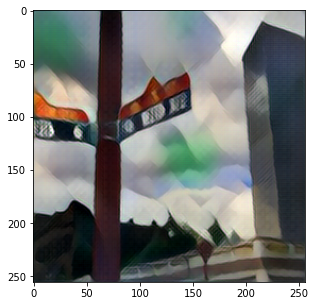

Saved sample stylized image at udnie/images/sample0_7000.png
========Iteration 7501/10126========
	Content Loss:	1978174.75
	Style Loss:	628868.87
	Total Loss:	2607040.43
Time elapsed:	680.1252331733704 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_7500.pth


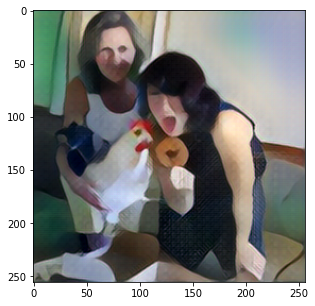

Saved sample stylized image at udnie/images/sample0_7500.png
========Iteration 8001/10126========
	Content Loss:	1959027.88
	Style Loss:	613612.04
	Total Loss:	2572636.02
Time elapsed:	725.2279629707336 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_8000.pth


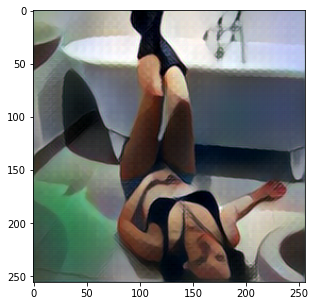

Saved sample stylized image at udnie/images/sample0_8000.png
========Iteration 8501/10126========
	Content Loss:	1943299.50
	Style Loss:	600220.92
	Total Loss:	2543517.04
Time elapsed:	770.52552485466 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_8500.pth


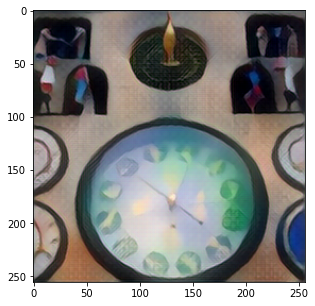

Saved sample stylized image at udnie/images/sample0_8500.png
========Iteration 9001/10126========
	Content Loss:	1927678.50
	Style Loss:	587997.94
	Total Loss:	2515674.48
Time elapsed:	815.6210899353027 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_9000.pth


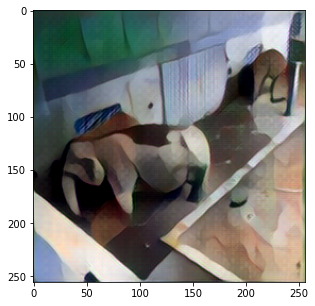

Saved sample stylized image at udnie/images/sample0_9000.png
========Iteration 9501/10126========
	Content Loss:	1912711.62
	Style Loss:	577207.81
	Total Loss:	2489917.79
Time elapsed:	861.2773854732513 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_9500.pth


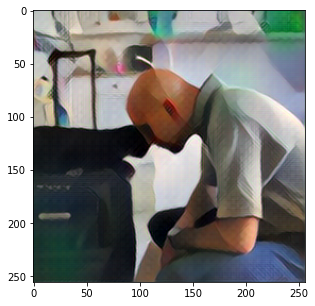

Saved sample stylized image at udnie/images/sample0_9500.png
========Iteration 10001/10126========
	Content Loss:	1899160.88
	Style Loss:	567298.10
	Total Loss:	2466457.57
Time elapsed:	906.24285364151 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_10000.pth


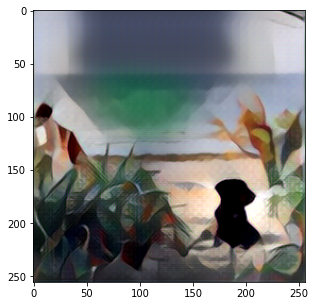

Saved sample stylized image at udnie/images/sample0_10000.png
========Iteration 10126/10126========
	Content Loss:	1895689.75
	Style Loss:	564979.54
	Total Loss:	2460667.13
Time elapsed:	917.804386138916 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_10125.pth


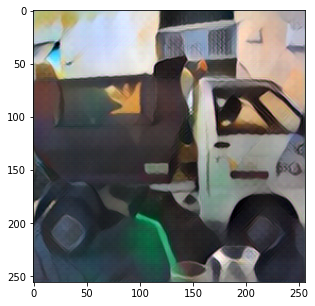

Saved sample stylized image at udnie/images/sample0_10125.png
Done Training the Network!
Training Time: 918.1655125617981 seconds
========Content Loss========
[23717386.0, 6482663.28493014, 4880383.822927073, 4176247.4139740174, 3765349.867003998, 3494460.3519092365, 3291474.5636871043, 3146257.5818337617, 3030134.815421145, 2938273.697039547, 2855998.209008198, 2793040.5286993273, 2739972.9476962173, 2691017.6469773883, 2646250.720914869, 2607040.4307092386, 2572636.0217004125, 2543517.043097871, 2515674.4837518055, 2489917.794034838, 2466457.573742626, 2460667.125530812]
========Style Loss========
[20238216.0, 3324268.3181137727, 1991598.402972028, 1504754.5556920387, 1248311.1509870065, 1086715.5945246902, 976307.2179585971, 896068.7570426307, 834695.7898416021, 786802.4288144301, 747600.1039917016, 715765.773285539, 688989.2142221088, 665817.3807659398, 646083.979161459, 628868.8697319524, 613612.0426372485, 600220.9225219827, 587997.9404979307, 577207.8068739475, 567298.1034630912

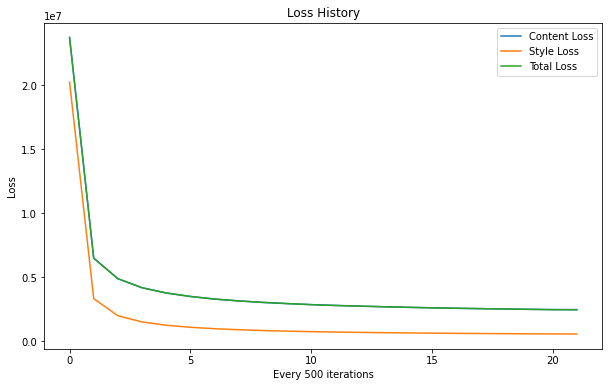

In [20]:
train()

In [21]:
# copy the models folder to the folder in the google drive
!cp -r udnie/models/ /content/gdrive/My\ Drive/vgg_coco/udnie/
# copy the images folder to the folder in the google drive
!cp -r udnie/images/ /content/gdrive/My\ Drive/vgg_coco/udnie/

## Wave

In [5]:
def train():
    # seeds
    torch.manual_seed(SEED)
    torch.cuda.manual_seed(SEED)
    np.random.seed(SEED)
    random.seed(SEED)

    # get the device
    device = ("cuda" if torch.cuda.is_available() else "cpu")

    # load the training dataset
    transform = transforms.Compose([
        transforms.Resize(TRAIN_IMAGE_SIZE),
        transforms.CenterCrop(TRAIN_IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Lambda(lambda x: x.mul(255))
    ])

    train_dataset = datasets.ImageFolder(DATASET_PATH, transform=transform)
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

    # load the models and start training :)
    model = vgg_model.VGG16('/content/vgg16-00b39a1b.pth').to(device) #Creating a pretrained model object by loading the downloaded .pth file. This model object will be retrained 
    vgg16_fe = vgg.VGG16('/content/vgg16-00b39a1b.pth').to(device) #Creating a pretrained model object by loading the downloaded .pth file. This model object will be used to extract features and will not be retrained

    # get style features
    imagenet_neg_mean = torch.tensor([-103.939, -116.779, -123.68], dtype=torch.float32).reshape(1,3,1,1).to(device)
    # load the style image
    style_image = utils.load_image(STYLE_IMAGE_PATH)
    # convert style image to tensor
    style_tensor = utils.itot(style_image).to(device)
    # add imagenet mean
    style_tensor = style_tensor.add(imagenet_neg_mean)

    B, C, H, W = style_tensor.shape
    # get the features of the style image
    style_features = vgg16_fe(style_tensor.expand([BATCH_SIZE, C, H, W]))

    # get the gram matrix of the style image
    style_gram = {}
    for key, value in style_features.items():
        style_gram[key] = utils.gram(value)

    # Optimizer settings
    optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=ADAM_LR)
    # optimizer = optim.Adam(model.parameters(), lr=ADAM_LR)

    # Loss trackers
    content_loss_history = []
    style_loss_history = []
    total_loss_history = []
    batch_content_loss_sum = 0
    batch_style_loss_sum = 0
    batch_total_loss_sum = 0

    # Optimization/Training Loop
    batch_count = 1
    start_time = time.time()

    # training loop
    for epoch in range(NUM_EPOCHS):
        print("========Epoch {}/{}========".format(epoch+1, NUM_EPOCHS))
        for content_batch, _ in train_loader:
            # Get current batch size in case of odd batch sizes
            curr_batch_size = content_batch.shape[0]

            # free up unnecessary memory of cuda
            torch.cuda.empty_cache()

            # zero the gradients
            optimizer.zero_grad()

            # Generate images and get features
            content_batch = content_batch[:,[2,1,0]].to(device)
            generated_batch = model(content_batch)

            # print("Content Batch: ", content_batch.shape)
            # print("Generated Batch: ", generated_batch.shape)

            content_features = vgg16_fe(content_batch.add(imagenet_neg_mean))
            generated_features = vgg16_fe(generated_batch.add(imagenet_neg_mean))

            # print("Generated Features:", generated_features['relu2_2'].shape)
            # print("Content Features:", content_features['relu2_2'].shape)

            # Calculate content loss
            MSELoss = nn.MSELoss().to(device)
            content_loss = CONTENT_WEIGHT * MSELoss(generated_features['relu2_2'], content_features['relu2_2'])            
            batch_content_loss_sum += content_loss

            # Calculate style loss
            style_loss = 0
            for key, value in generated_features.items():
                s_loss = MSELoss(utils.gram(value), style_gram[key][:curr_batch_size])
                style_loss += s_loss
            style_loss *= STYLE_WEIGHT
            batch_style_loss_sum += style_loss.item()

            # Calculate total loss
            total_loss = content_loss + style_loss
            batch_total_loss_sum += total_loss.item()

            # Backpropagation
            total_loss.backward()
            optimizer.step()

            # Save Model and Print Losses
            if (((batch_count-1)%SAVE_MODEL_EVERY == 0) or (batch_count==NUM_EPOCHS*len(train_loader))):
                # Print Losses
                print("========Iteration {}/{}========".format(batch_count, NUM_EPOCHS*len(train_loader)))
                print("\tContent Loss:\t{:.2f}".format(batch_content_loss_sum/batch_count))
                print("\tStyle Loss:\t{:.2f}".format(batch_style_loss_sum/batch_count))
                print("\tTotal Loss:\t{:.2f}".format(batch_total_loss_sum/batch_count))
                print("Time elapsed:\t{} seconds".format(time.time()-start_time))

                # Save Model
                checkpoint_path = SAVE_MODEL_PATH + "checkpoint_" + str(batch_count-1) + ".pth"
                torch.save(model.state_dict(), checkpoint_path)
                
                print("Saved self trained VGG16 checkpoint file at {}".format(checkpoint_path))

                # Save sample generated image
                sample_tensor = generated_batch[0].clone().detach().unsqueeze(dim=0) # clone to save inplace errors
                sample_image = utils.ttoi(sample_tensor.clone().detach())
                sample_image_path = SAVE_IMAGE_PATH + "sample0_" + str(batch_count-1) + ".png"
                utils.saveimg(sample_image, sample_image_path)
                utils.show(sample_image)
                print("Saved sample stylized image at {}".format(sample_image_path))

                # Save loss histories
                content_loss_history.append(batch_total_loss_sum/batch_count)
                style_loss_history.append(batch_style_loss_sum/batch_count)
                total_loss_history.append(batch_total_loss_sum/batch_count)
            
            # increment batch count
            batch_count += 1
    
    stop_time = time.time()
    # Print loss histories
    print("Done Training the Network!")
    print("Training Time: {} seconds".format(stop_time-start_time))
    print("========Content Loss========")
    print(content_loss_history) 
    print("========Style Loss========")
    print(style_loss_history) 
    print("========Total Loss========")
    print(total_loss_history) 

    # Save TransformerNetwork weights
    model.eval()
    model.cpu()
    final_path = SAVE_MODEL_PATH + "transformer_weight.pth"
    print("Saving VGG16 weights at {}".format(final_path))
    torch.save(model.state_dict(), final_path)
    print("Done saving final model")

    # Plot Loss Histories
    if (PLOT_LOSS):
        utils.plot_loss_hist(content_loss_history, style_loss_history, total_loss_history)


In [6]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = "train"
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/wave.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 17 # 17
STYLE_WEIGHT = 50 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "wave/models/"
SAVE_IMAGE_PATH = "wave/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

========Epoch 1/1========
========Iteration 1/10126========
	Content Loss:	3479169.50
	Style Loss:	38468648.00
	Total Loss:	41947816.00
Time elapsed:	0.1541001796722412 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_0.pth


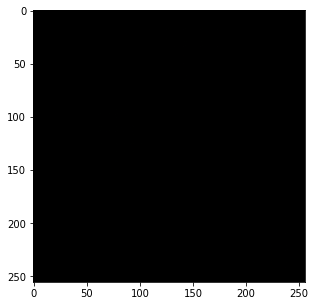

Saved sample stylized image at wave/images/sample0_0.png
========Iteration 501/10126========
	Content Loss:	4125321.50
	Style Loss:	6399311.94
	Total Loss:	10524633.31
Time elapsed:	44.3155198097229 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_500.pth


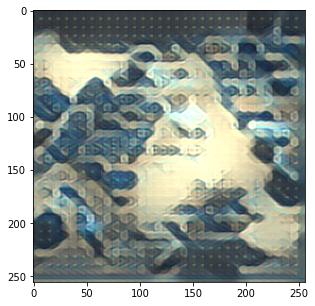

Saved sample stylized image at wave/images/sample0_500.png
========Iteration 1001/10126========
	Content Loss:	3831265.25
	Style Loss:	3539530.83
	Total Loss:	7370794.98
Time elapsed:	90.65693736076355 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_1000.pth


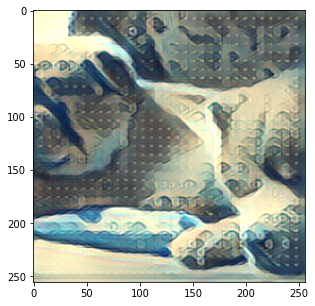

Saved sample stylized image at wave/images/sample0_1000.png
========Iteration 1501/10126========
	Content Loss:	3597216.50
	Style Loss:	2553737.35
	Total Loss:	6150954.53
Time elapsed:	150.91814136505127 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_1500.pth


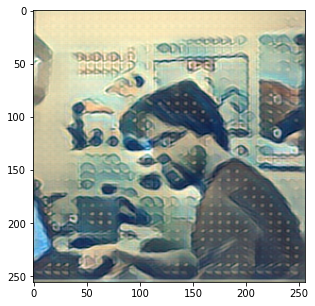

Saved sample stylized image at wave/images/sample0_1500.png
========Iteration 2001/10126========
	Content Loss:	3420705.75
	Style Loss:	2050651.08
	Total Loss:	5471353.42
Time elapsed:	209.79042530059814 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_2000.pth


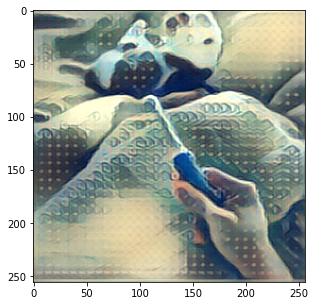

Saved sample stylized image at wave/images/sample0_2000.png
========Iteration 2501/10126========
	Content Loss:	3290140.25
	Style Loss:	1744630.77
	Total Loss:	5034767.57
Time elapsed:	268.60058093070984 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_2500.pth


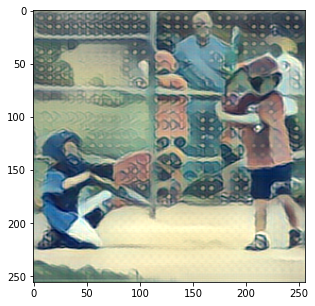

Saved sample stylized image at wave/images/sample0_2500.png
========Iteration 3001/10126========
	Content Loss:	3179965.50
	Style Loss:	1537699.82
	Total Loss:	4717662.06
Time elapsed:	326.5616433620453 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_3000.pth


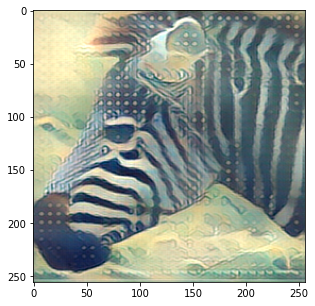

Saved sample stylized image at wave/images/sample0_3000.png
========Iteration 3501/10126========
	Content Loss:	3097514.50
	Style Loss:	1388799.52
	Total Loss:	4486307.33
Time elapsed:	386.1431722640991 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_3500.pth


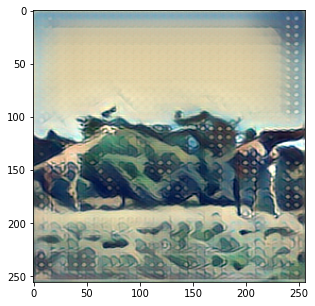

Saved sample stylized image at wave/images/sample0_3500.png
========Iteration 4001/10126========
	Content Loss:	3027311.00
	Style Loss:	1276170.14
	Total Loss:	4303475.93
Time elapsed:	444.45912623405457 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_4000.pth


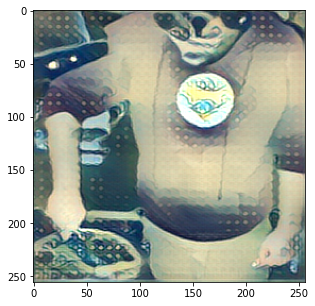

Saved sample stylized image at wave/images/sample0_4000.png
========Iteration 4501/10126========
	Content Loss:	2969550.25
	Style Loss:	1187667.69
	Total Loss:	4157213.53
Time elapsed:	501.74346017837524 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_4500.pth


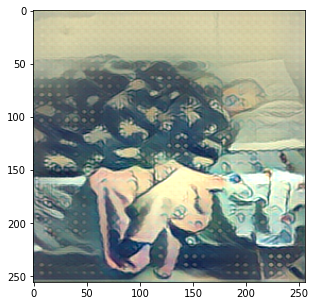

Saved sample stylized image at wave/images/sample0_4500.png
========Iteration 5001/10126========
	Content Loss:	2916368.00
	Style Loss:	1116392.08
	Total Loss:	4032757.33
Time elapsed:	558.0872619152069 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_5000.pth


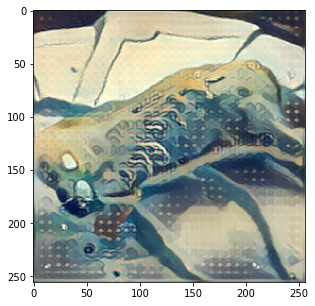

Saved sample stylized image at wave/images/sample0_5000.png
========Iteration 5501/10126========
	Content Loss:	2874609.50
	Style Loss:	1057965.92
	Total Loss:	3932574.38
Time elapsed:	614.3074154853821 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_5500.pth


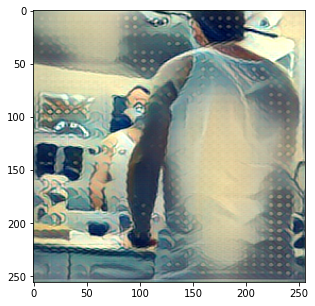

Saved sample stylized image at wave/images/sample0_5500.png
========Iteration 6001/10126========
	Content Loss:	2837943.75
	Style Loss:	1009120.84
	Total Loss:	3847065.03
Time elapsed:	670.1112196445465 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_6000.pth


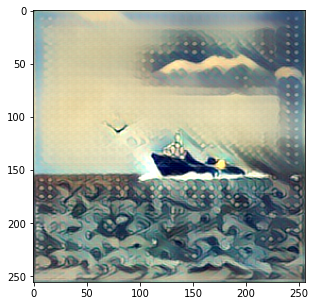

Saved sample stylized image at wave/images/sample0_6000.png
========Iteration 6501/10126========
	Content Loss:	2803512.25
	Style Loss:	967235.72
	Total Loss:	3770747.14
Time elapsed:	725.2874870300293 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_6500.pth


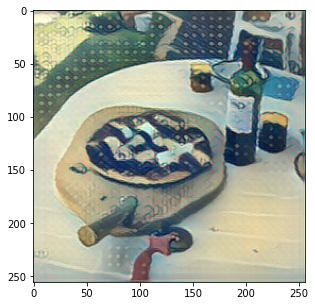

Saved sample stylized image at wave/images/sample0_6500.png
========Iteration 7001/10126========
	Content Loss:	2771372.00
	Style Loss:	931117.45
	Total Loss:	3702487.57
Time elapsed:	779.7005169391632 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_7000.pth


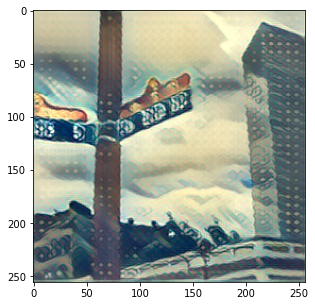

Saved sample stylized image at wave/images/sample0_7000.png
========Iteration 7501/10126========
	Content Loss:	2743043.75
	Style Loss:	899959.17
	Total Loss:	3642999.78
Time elapsed:	833.8560841083527 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_7500.pth


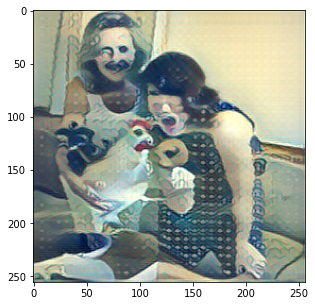

Saved sample stylized image at wave/images/sample0_7500.png
========Iteration 8001/10126========
	Content Loss:	2717800.25
	Style Loss:	872524.23
	Total Loss:	3590320.76
Time elapsed:	885.0439176559448 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_8000.pth


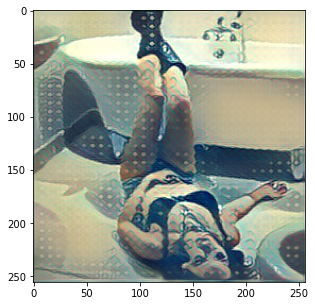

Saved sample stylized image at wave/images/sample0_8000.png
========Iteration 8501/10126========
	Content Loss:	2695531.50
	Style Loss:	848141.80
	Total Loss:	3543669.05
Time elapsed:	938.6519818305969 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_8500.pth


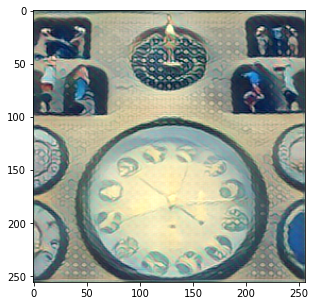

Saved sample stylized image at wave/images/sample0_8500.png
========Iteration 9001/10126========
	Content Loss:	2674180.75
	Style Loss:	826254.22
	Total Loss:	3500430.27
Time elapsed:	991.6141753196716 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_9000.pth


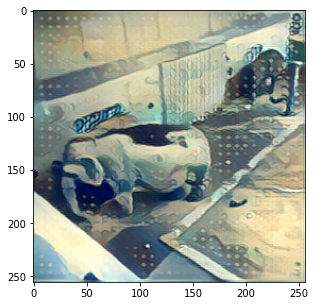

Saved sample stylized image at wave/images/sample0_9000.png
========Iteration 9501/10126========
	Content Loss:	2653945.25
	Style Loss:	806548.19
	Total Loss:	3460486.56
Time elapsed:	1044.797443151474 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_9500.pth


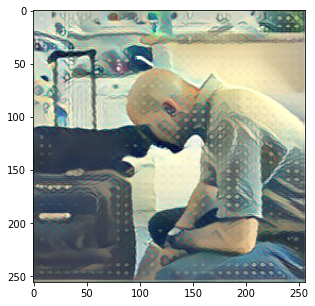

Saved sample stylized image at wave/images/sample0_9500.png
========Iteration 10001/10126========
	Content Loss:	2635456.75
	Style Loss:	788690.06
	Total Loss:	3424141.02
Time elapsed:	1096.6353058815002 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_10000.pth


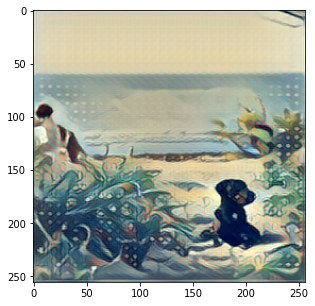

Saved sample stylized image at wave/images/sample0_10000.png
========Iteration 10126/10126========
	Content Loss:	2631043.50
	Style Loss:	784516.30
	Total Loss:	3415554.09
Time elapsed:	1110.074019908905 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_10125.pth


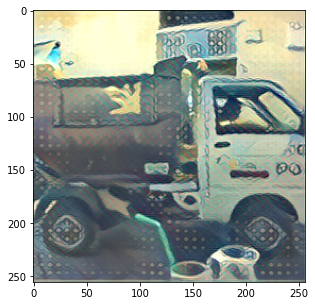

Saved sample stylized image at wave/images/sample0_10125.png
Done Training the Network!
Training Time: 1110.4690155982971 seconds
========Content Loss========
[41947816.0, 10524633.308882235, 7370794.9772727275, 6150954.531145902, 5471353.415042479, 5034767.567872851, 4717662.060146618, 4486307.325192802, 4303475.926080979, 4157213.527216174, 4032757.3343331334, 3932574.377204145, 3847065.0250374936, 3770747.138517151, 3702487.570347093, 3642999.7811625116, 3590320.7584676915, 3543669.0529937656, 3500430.2711087656, 3460486.564177455, 3424141.0214978503, 3415554.094064784]
========Style Loss========
[38468648.0, 6399311.944735529, 3539530.826486014, 2553737.350266489, 2050651.082411919, 1744630.7662435025, 1537699.823902449, 1388799.5230826905, 1276170.1387387528, 1187667.685535159, 1116392.078365577, 1057965.9240251773, 1009120.8365532828, 967235.7178799416, 931117.4508730896, 899959.1748600187, 872524.2339512248, 848141.7963033761, 826254.2184653094, 806548.1929139039, 788690.0574661

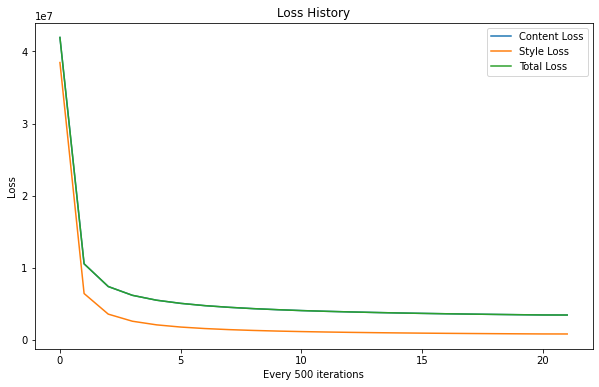

In [7]:
train()

In [8]:
# copy the models folder to the folder in the google drive
!cp -r wave/models/ /content/gdrive/My\ Drive/vgg_coco/wave/
# copy the images folder to the folder in the google drive
!cp -r wave/images/ /content/gdrive/My\ Drive/vgg_coco/wave/